In [2]:
from share import *
import config

import cv2
import einops
#import gradio as gr
import numpy as np
import torch
import random

from pytorch_lightning import seed_everything
from annotator.util import resize_image, HWC3
from annotator.hed import HEDdetector
from cldm.model import create_model, load_state_dict
from cldm.ddim_hacked import DDIMSampler

import os
import pandas as pd
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2

/home/yuebing/.conda/envs/controlnet_hemy/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


logging improved.


In [3]:
device = torch.device('cuda:3')
print(device)  # 输出：device(type='cuda', index=1)
torch.cuda.set_device(device)
# 检查设备是否正确设置
if torch.cuda.is_available():
    print(f"Using device: {torch.cuda.get_device_name(device)}")
else:
    print("CUDA is not available.")

cuda:3
Using device: NVIDIA GeForce RTX 3090


In [4]:
if torch.cuda.is_available():
    print(f"Currently using GPU: {torch.cuda.current_device()}")
    print(f"GPU name: {torch.cuda.get_device_name(torch.cuda.current_device())}")
    print(f"Total memory: {torch.cuda.get_device_properties(torch.cuda.current_device()).total_memory}")
else:
    print("No GPU is being used.")

Currently using GPU: 3
GPU name: NVIDIA GeForce RTX 3090
Total memory: 25430786048


In [5]:
city_dic={'chicago': 'Chicago', 'dallas':'Dallas', 'la':'Los Angeles'}

In [60]:
ckpt_list = [
    #{'version': '', 'epoch': '4', 'step': '72784'},
    {'version': '', 'epoch': '9', 'step': '145569'},
    {'version': '', 'epoch': '14', 'step': '218354'}
]

In [6]:
ckpt_list = [
    {'version': '', 'epoch': '19', 'step': '291139'},
    {'version': '', 'epoch': '24', 'step': '363924'},
    {'version': '', 'epoch': '29', 'step': '436709'},
    {'version': '', 'epoch': '34', 'step': '509494'}
]

In [7]:
dir_hemy = '/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/'
image_dir = dir_hemy + 'Vector_Image_Partition/'

city = 'NewYork'
data_dir = [dir_hemy + 'Descriptions_s3/NewYork_grid_r0_d0.csv',
            dir_hemy + 'Descriptions_s3/NewYork_grid_r1_d0.csv',
            dir_hemy + 'Descriptions_s3/NewYork_grid_r2_d0.csv',
            dir_hemy + 'Descriptions_s3/NewYork_grid_r0_d1.csv',
            dir_hemy + 'Descriptions_s3/NewYork_grid_r1_d1.csv',
            dir_hemy + 'Descriptions_s3/NewYork_grid_r2_d1.csv',
            dir_hemy + 'Descriptions_s3/NewYork_grid_r0_d2.csv',
            dir_hemy + 'Descriptions_s3/NewYork_grid_r1_d2.csv',
            dir_hemy + 'Descriptions_s3/NewYork_grid_r2_d2.csv']

In [8]:
df = pd.DataFrame() 
for f in data_dir: 
    dfi = pd.read_csv(f)
    df = pd.concat([df, dfi[dfi['Train']==0]])
print(df.shape)
df.head()

(7349, 34)


,Unnamed: 0,geometry,left_x,top_y,row,col,index_right,FID,r,d,...,cv_area,cv_height,bu_sum_vol_category,bu_num_category,bu_sum_area_category,cv_area_category,bu_mean_height_category,cv_height_category,descriptions,Train
17,333,POLYGON ((279865.7200310936 38577.641927330675...,279415.720031,39027.641927,9,3,0,0,r0,d0,...,1.653114,0.251711,low,medium,medium,medium,medium,medium,"The total building volume is low, the number o...",0
20,336,POLYGON ((279865.7200310936 39927.641927330675...,279415.720031,40377.641927,12,3,0,0,r0,d0,...,0.643268,0.233608,low,low,low,low,medium,medium,"The total building volume is low, the number o...",0
26,437,POLYGON ((280315.7200310936 36777.641927330675...,279865.720031,37227.641927,5,4,0,0,r0,d0,...,0.968498,0.195918,low,low,low,low,medium,low,"The total building volume is low, the number o...",0
28,439,POLYGON ((280315.7200310936 37677.641927330675...,279865.720031,38127.641927,7,4,0,0,r0,d0,...,0.523630,0.244806,low,low,medium,low,medium,medium,"The total building volume is low, the number o...",0
30,441,POLYGON ((280315.7200310936 38577.641927330675...,279865.720031,39027.641927,9,4,0,0,r0,d0,...,1.792379,0.294982,low,low,medium,medium,medium,medium,"The total building volume is low, the number o...",0


In [9]:
torch.cuda.current_device()

3

In [10]:
def load_model(ckpt_path, device):
    
    # 清理 GPU 内存
    torch.cuda.empty_cache()
    
    # 删除旧模型引用（如果存在）
    if 'model' in globals():
        del globals()['model']
    if 'ddim_sampler' in globals():
        del globals()['ddim_sampler']
    
    # 再次清理 GPU 内存
    torch.cuda.empty_cache()
    
    # 1. 创建模型实例
    model = create_model('./models/cldm_v15.yaml').cpu()
    
    # 2. 加载模型状态字典
    #ckpt_path = f'./checkpoints/epoch={epoch}-step={step}.ckpt'
    #ckpt_path = f'./version_archive/version_{version}_e{epoch}/checkpoints/epoch={epoch}-step={step}.ckpt'
    model.load_state_dict(load_state_dict(ckpt_path, location='cpu'))
    
    # 3. 将模型移动到指定设备
    model.to(device)
    
    # 4. 创建采样器实例
    ddim_sampler = DDIMSampler(model)
    
    return model, ddim_sampler

In [11]:
def process(infer_stage, xtile, ytile, r, d, zoom, input_city, output_city, prompt, a_prompt, n_prompt, num_samples, image_resolution, detect_resolution, ddim_steps, guess_mode, strength, scale, seed, eta, v=None, RGB=True):
    
    with torch.no_grad():
        if infer_stage == 3:
            hint_name = image_dir + city + '_Stage_2_' + r + '_' + d + '/' + str(xtile) + '_' + str(ytile) + '_' + r + '_' + d + '.tif'
            img_name =  image_dir + city + '_Stage_3_' + r + '_' + d + '/' + str(xtile) + '_' + str(ytile) + '_' + r + '_' + d + '.tif' 
        elif infer_stage == 2:
            hint_name = image_dir + city + '_Stage_1_' + r + '_' + d + '/' + str(xtile) + '_' + str(ytile) + '_' + r + '_' + d + '.tif'
            img_name =  image_dir + city + '_Stage_2_' + r + '_' + d + '/' + str(xtile) + '_' + str(ytile) + '_' + r + '_' + d + '.tif' 
            
        input_image = cv2.imread(img_name)
        input_image = np.array(input_image)
        print(img_name)
        H,W,C = input_image.shape
   
        detected_map = cv2.imread(hint_name, cv2.IMREAD_UNCHANGED)
        detected_map = np.array(detected_map)    
        
        if detected_map.shape[2] == 4:
            # convert 4-channel source image to 3-channel
            #make mask of where the transparent bits are
            trans_mask = detected_map[:,:,3] == 0
    
            #replace areas of transparency with white and not transparent
            detected_map[trans_mask] = [255, 255, 255, 255]
    
            #new image without alpha channel...
            detected_map = cv2.cvtColor(detected_map, cv2.COLOR_BGRA2BGR)        
        
        #OpenCV read images in BGR order.
        control = cv2.cvtColor(detected_map, cv2.COLOR_BGR2RGB)
        control = torch.from_numpy(control.copy()).float().cuda() / 255.0
        control = torch.stack([control for _ in range(num_samples)], dim=0)
        control = einops.rearrange(control, 'b h w c -> b c h w').clone()

        if seed == -1:
            seed = random.randint(0, 65535)
        seed_everything(seed)

        if config.save_memory:
            model.low_vram_shift(is_diffusing=False)
            
        cond = {"c_concat": [control], "c_crossattn": [model.get_learned_conditioning([prompt + ', ' + a_prompt] * num_samples)]}
        un_cond = {"c_concat": None if guess_mode else [control], "c_crossattn": [model.get_learned_conditioning([n_prompt] * num_samples)]}
        shape = (4, H // 8, W // 8)

        if config.save_memory:
            model.low_vram_shift(is_diffusing=True)

        model.control_scales = [strength * (0.825 ** float(12 - i)) for i in range(13)] if guess_mode else ([strength] * 13)  # Magic number. IDK why. Perhaps because 0.825**12<0.01 but 0.826**12>0.01
        samples, intermediates = ddim_sampler.sample(ddim_steps, num_samples,
                                                     shape, cond, verbose=False, eta=eta,
                                                     unconditional_guidance_scale=scale,
                                                     unconditional_conditioning=un_cond)
            
        if config.save_memory:
            model.low_vram_shift(is_diffusing=False)

        x_samples = model.decode_first_stage(samples)
        x_samples = (einops.rearrange(x_samples, 'b c h w -> b h w c') * 127.5 + 127.5).cpu().numpy().clip(0, 255).astype(np.uint8)

        if RGB:
            results = [x_samples[i] for i in range(num_samples)]
            detected_map = cv2.cvtColor(detected_map, cv2.COLOR_BGR2RGB)
        else:
            results = [cv2.cvtColor(x_samples[i], cv2.COLOR_RGB2BGR) for i in range(num_samples)]

        return [detected_map] + [input_image] + results


In [12]:
zoom = "16"
num_samples = 1
image_resolution = 512
strength = 1.0
guess_mode = False
detect_resolution = 512
ddim_steps = 20
scale = 9.0
seed = 5354
eta = 0.0
a_prompt = 'best quality, extremely detailed'
n_prompt = 'longbody, lowres, bad anatomy, bad hands, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality'

In [48]:
import random

data = list(range(7349))

# 随机选择100个不同的行号
random_indices = random.sample(data, 100)

#selected_ranges = [range(index, index+1) for index in random_indices]

# 打印结果
for r in random_indices:
    print(r)

4873
2043
7119
740
424
3627
3270
2934
4604
694
2859
7202
6899
6184
5304
6843
5619
801
5881
7080
4391
292
2845
3910
1979
5539
2195
2670
4959
1519
3215
4139
9
3631
54
4805
3404
6939
7051
857
1070
6765
64
2534
7284
4908
6404
6611
5282
5820
5357
294
4840
1630
2616
3351
6560
5906
2720
5567
1785
6530
7277
5376
3179
342
5000
6726
838
1880
4453
6183
5451
642
4867
5339
7128
2557
128
2650
1024
2871
60
1172
5634
363
3872
6405
1302
846
6668
5329
641
3253
7038
734
5362
1497
1072
6478


In [13]:
random_indices = [4873,2043,7119,740,424,3627,3270,2934,4604,694,2859,7202,6899,6184,5304,
                  6843,5619,801,5881,7080,4391,292,2845,3910,1979,5539,2195,2670,4959,1519,
                  3215,4139,9,3631,54,4805,3404,6939,7051,857,1070,6765,64,2534,7284,4908,
                  6404,6611,5282,5820,5357,294,4840,1630,2616,3351,6560,5906,2720,5567,1785,
                  6530,7277,5376,3179,342,5000,6726,838,1880,4453,6183,5451,642,4867,5339,
                  7128,2557,128,2650,1024,2871,60,1172,5634,363,3872,6405,1302,846,6668,5329,
                  641,3253,7038,734,5362,1497,1072,6478]

In [14]:
def convert_bgr_to_rgb(image):
    """
    将 BGR 图像转换为 RGB 图像。
    """
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [15]:
device

device(type='cuda', index=3)

In [16]:
ckpt_list

[{'version': '', 'epoch': '19', 'step': '291139'},
 {'version': '', 'epoch': '24', 'step': '363924'},
 {'version': '', 'epoch': '29', 'step': '436709'},
 {'version': '', 'epoch': '34', 'step': '509494'}]

cuda:3
No module 'xformers'. Proceeding without it.
ControlLDM: Running in eps-prediction mode
DiffusionWrapper has 859.52 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Loaded model config from [./models/cldm_v15.yaml]
Loaded state_dict from [./checkpoints/epoch=19-step=291139.ckpt]


Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/63_94_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:09<00:00,  2.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/82_65_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/78_75_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.78it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/59_92_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.40it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/96_66_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/51_62_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.37it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/48_97_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.39it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/50_68_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.06it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/77_71_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  4.00it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/78_85_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.61it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/43_64_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/63_83_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/89_61_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/47_70_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.02it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/37_67_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/53_58_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.07it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/34_91_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.94it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/67_101_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.94it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/56_46_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/102_72_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.18it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/50_58_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/83_57_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.94it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/47_63_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.03it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/77_81_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.62it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/19_61_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/61_83_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.25it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/41_76_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/69_50_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/19_17_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.19it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/55_88_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/40_90_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/21_17_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/17_5_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/68_62_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.27it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/38_16_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/51_87_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.85it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/31_30_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/26_64_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/105_70_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/15_14_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.87it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/74_54_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_52_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.88it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/18_18_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.93it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/29_22_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.72it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/31_91_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.69it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/6_3_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.19it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/99_87_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.02it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/40_20_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.19it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/67_65_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/39_27_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.28it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/45_70_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/29_58_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.79it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/48_91_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.88it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/17_4_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.81it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/42_45_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/33_18_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.08it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/21_12_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.76it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/53_49_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.86it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/77_54_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/77_85_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.98it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/35_41_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.97it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/18_7_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_90_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.84it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/59_71_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.28it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/39_87_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/93_61_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/37_24_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.89it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_48_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/15_12_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/31_53_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.28it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/39_62_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.05it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/44_70_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.74it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/26_77_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.85it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/90_81_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.03it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/65_93_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.15it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/30_69_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/88_76_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/20_27_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.11it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/37_30_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/38_49_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.19it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/43_50_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.02it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/33_65_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/34_17_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.01it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/34_62_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/94_91_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/52_63_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/92_78_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.14it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/37_88_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/98_70_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.14it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/25_12_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.99it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/30_30_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/46_68_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.88it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/87_81_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/48_95_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.27it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/54_70_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/44_91_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/71_70_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/99_86_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/78_54_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/56_95_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.11it/s]


ControlLDM: Running in eps-prediction mode
DiffusionWrapper has 859.52 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Loaded model config from [./models/cldm_v15.yaml]
Loaded state_dict from [./checkpoints/epoch=24-step=363924.ckpt]


Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/63_94_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.20it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/82_65_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.25it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/78_75_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.08it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/59_92_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.11it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/96_66_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.40it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/51_62_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.37it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/48_97_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.40it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/50_68_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/77_71_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/78_85_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/43_64_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/63_83_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/89_61_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/47_70_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/37_67_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/53_58_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/34_91_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.94it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/67_101_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/56_46_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/102_72_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.27it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/50_58_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/83_57_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/47_63_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.05it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/77_81_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/19_61_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/61_83_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/41_76_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.94it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/69_50_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/19_17_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.15it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/55_88_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/40_90_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.11it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/21_17_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/17_5_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.14it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/68_62_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.76it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/38_16_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/51_87_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.94it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/31_30_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/26_64_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.15it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/105_70_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/15_14_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.06it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/74_54_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_52_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/18_18_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/29_22_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/31_91_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.87it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/6_3_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.90it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/99_87_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/40_20_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/67_65_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/39_27_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/45_70_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.07it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/29_58_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.01it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/48_91_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.94it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/17_4_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.08it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/42_45_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/33_18_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.74it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/21_12_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.27it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/53_49_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/77_54_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.29it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/77_85_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.28it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/35_41_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.98it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/18_7_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_90_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.01it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/59_71_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/39_87_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/93_61_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.95it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/37_24_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_48_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/15_12_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/31_53_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/39_62_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.06it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/44_70_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.03it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/26_77_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/90_81_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/65_93_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.07it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/30_69_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/88_76_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/20_27_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/37_30_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/38_49_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.90it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/43_50_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/33_65_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/34_17_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/34_62_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/94_91_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.18it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/52_63_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/92_78_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/37_88_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.84it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/98_70_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/25_12_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/30_30_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/46_68_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/87_81_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/48_95_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/54_70_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/44_91_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/71_70_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.25it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/99_86_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/78_54_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/56_95_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]


ControlLDM: Running in eps-prediction mode
DiffusionWrapper has 859.52 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Loaded model config from [./models/cldm_v15.yaml]
Loaded state_dict from [./checkpoints/epoch=29-step=436709.ckpt]


Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/63_94_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/82_65_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.41it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/78_75_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.04it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/59_92_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.99it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/96_66_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.38it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/51_62_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/48_97_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.98it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/50_68_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.82it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/77_71_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.02it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/78_85_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/43_64_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.98it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/63_83_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/89_61_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.84it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/47_70_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.79it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/37_67_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.95it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/53_58_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.87it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/34_91_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.03it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/67_101_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.11it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/56_46_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/102_72_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.94it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/50_58_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/83_57_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.08it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/47_63_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.78it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/77_81_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.20it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/19_61_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/61_83_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/41_76_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/69_50_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/19_17_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/55_88_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/40_90_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/21_17_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/17_5_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/68_62_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/38_16_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.86it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/51_87_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.05it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/31_30_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.29it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/26_64_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.86it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/105_70_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/15_14_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/74_54_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_52_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/18_18_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.20it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/29_22_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/31_91_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.03it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/6_3_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/99_87_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.28it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/40_20_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/67_65_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/39_27_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/45_70_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/29_58_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/48_91_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.04it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/17_4_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/42_45_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/33_18_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/21_12_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/53_49_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/77_54_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.28it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/77_85_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/35_41_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.07it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/18_7_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_90_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.29it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/59_71_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/39_87_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/93_61_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.14it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/37_24_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_48_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/15_12_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.16it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/31_53_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/39_62_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.79it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/44_70_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.95it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/26_77_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/90_81_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/65_93_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.98it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/30_69_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/88_76_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/20_27_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/37_30_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/38_49_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.19it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/43_50_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/33_65_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/34_17_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/34_62_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/94_91_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/52_63_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.27it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/92_78_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.03it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/37_88_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/98_70_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.78it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/25_12_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/30_30_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/46_68_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/87_81_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/48_95_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.08it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/54_70_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.71it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/44_91_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/71_70_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.88it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/99_86_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.78it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/78_54_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.90it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/56_95_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]


ControlLDM: Running in eps-prediction mode
DiffusionWrapper has 859.52 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Loaded model config from [./models/cldm_v15.yaml]
Loaded state_dict from [./checkpoints/epoch=34-step=509494.ckpt]


Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/63_94_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/82_65_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.93it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/78_75_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/59_92_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/96_66_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/51_62_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/48_97_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.09it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/50_68_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/77_71_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.27it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/78_85_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.39it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/43_64_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.37it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/63_83_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/89_61_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.24it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/47_70_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/37_67_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.91it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/53_58_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.02it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/34_91_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.99it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/67_101_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/56_46_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.20it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/102_72_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.11it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/50_58_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.06it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/83_57_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.78it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/47_63_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.19it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/77_81_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/19_61_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.02it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/61_83_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.86it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/41_76_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.06it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/69_50_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.70it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/19_17_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.76it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/55_88_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/40_90_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.03it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/21_17_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.15it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/17_5_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/68_62_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.86it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/38_16_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/51_87_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.91it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/31_30_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.85it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/26_64_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/105_70_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.21it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/15_14_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/74_54_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.92it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_52_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.19it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/18_18_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.10it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/29_22_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/31_91_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.88it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/6_3_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.05it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/99_87_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/40_20_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/67_65_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.04it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/39_27_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.02it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/45_70_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/29_58_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.06it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/48_91_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.76it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/17_4_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/42_45_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/33_18_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.28it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/21_12_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/53_49_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/77_54_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/77_85_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.20it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/35_41_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/18_7_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.33it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_90_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/59_71_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.18it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/39_87_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.29it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/93_61_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.07it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/37_24_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.20it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/48_48_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/15_12_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.95it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d0/31_53_r2_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.27it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/39_62_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.12it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/44_70_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.29it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/26_77_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/90_81_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.29it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d1/65_93_r2_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.13it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/30_69_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.18it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/88_76_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.99it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/20_27_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.36it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/37_30_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.07it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/38_49_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.05it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/43_50_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.18it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/33_65_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.00it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/34_17_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.31it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/34_62_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.01it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/94_91_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:05<00:00,  3.95it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/52_63_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.30it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d1/92_78_r1_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/37_88_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.34it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/98_70_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/25_12_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/30_30_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.22it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/46_68_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.14it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/87_81_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.20it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d1/48_95_r0_d1.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.23it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r2_d2/54_70_r2_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.14it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d0/44_91_r0_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.26it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r0_d2/71_70_r0_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.32it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/99_86_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.35it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d0/78_54_r1_d0.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.11it/s]
Global seed set to 5354


/home/yuebing/Mingyi/GenerativeUrbanDesign/Urban_Data/Vector_Image_Partition/NewYork_Stage_3_r1_d2/56_95_r1_d2.tif
Data shape for DDIM sampling is (1, 4, 64, 64), eta 0.0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|█████████████████████████████| 20/20 [00:04<00:00,  4.08it/s]


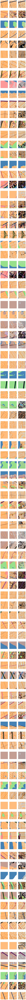

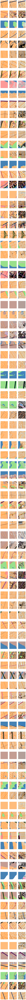

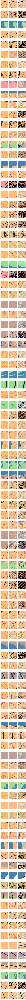

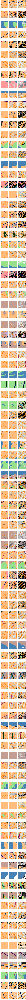

In [17]:
infer_stage = 3
input_city = 'NewYork'
output_city = 'NewYork'
print(device)

for e in range(len(ckpt_list)):
    
    version = ckpt_list[e]['version']
    epoch = ckpt_list[e]['epoch']
    step = ckpt_list[e]['step']
    ckpt_path = f'./checkpoints/epoch={epoch}-step={step}.ckpt'
    
    model, ddim_sampler = load_model(ckpt_path, device)
    
    outputs = []
    
    output_file = './output_image/stage_3_0701/epoch_' + ckpt_list[e]['epoch']
    os.makedirs(output_file, exist_ok=True)

    for i in random_indices:
    
        xtile = df.iloc[i]['row']
        ytile = df.iloc[i]['col']
        right = df.iloc[i]['r']
        down  = df.iloc[i]['d']
        
        prompt = df.iloc[i]['descriptions']
        #prompt = df.loc[(int(xtile),int(ytile))]['Land_use_description']
        
        RGB=True
        outputs_i = process(infer_stage, xtile, ytile, right, down, zoom, input_city, output_city, prompt, a_prompt, n_prompt, num_samples, image_resolution, detect_resolution, ddim_steps, guess_mode, strength, scale, seed, eta, v='0', RGB=RGB)
        outputs.append(outputs_i)
        
        # Save each image with the desired naming convention
        image = outputs_i[2]
        filename = f'{xtile}_{ytile}_{right}_{down}.png'
        plt.imsave(os.path.join(output_file,filename), image)
    
    
    fig, ax = plt.subplots(100,3, figsize=(6,240))
    #fig, ax = plt.subplots(5,3, figsize=(6,12))
    for x in range(100):
        for y in range(3):
            if y == 1:
                ax[x,y].imshow(convert_bgr_to_rgb(outputs[x][y]))
            else:
                ax[x,y].imshow(outputs[x][y])
    
    for ax in ax.ravel():
        ax.set_axis_off()
    os.makedirs('./output_image/stage_3_0701_summary', exist_ok=True)
    fig.savefig('./output_image/stage_3_0701_summary/output_image_e'+ckpt_list[e]['epoch']+'.png', bbox_inches='tight')

In [56]:
len(outputs)

100

In [ ]:
fig, ax = plt.subplots(100,3, figsize=(6,240))
#fig, ax = plt.subplots(5,3, figsize=(6,12))
for x in range(100):
    for y in range(3):
        if y == 1:
            ax[x,y].imshow(convert_bgr_to_rgb(outputs[x][y]))
        else:
            ax[x,y].imshow(outputs[x][y])

for ax in ax.ravel():
    ax.set_axis_off()
os.makedirs('./output_image/stage_3_0701_summary', exist_ok=True)
fig.savefig('./output_image/stage_3_0701_summary/output_image_e'+ckpt_list[e]['epoch']+'.png', bbox_inches='tight')